# What we have done so far?
* We did some data exploration and semantic analysis with a hypothesis and tested it using two different approaches
* We tested different vectorization techniques on different classifiers
* We Justified our models decisions using LIME
* We used Glove embeddings with fully connected nn, LSTM, Bidirectional LSTM and GRU


In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory
import seaborn as sns
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# Any results you write to the current directory are saved as output.

/kaggle/input/glove6b100dtxt/glove.6B.100d.txt
/kaggle/input/twitter-airline-sentiment/database.sqlite
/kaggle/input/twitter-airline-sentiment/Tweets.csv


  ## Data Exploration 
  


In [2]:
df = pd.read_csv('/kaggle/input/twitter-airline-sentiment/Tweets.csv')
df.head()

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,airline_sentiment_gold,name,negativereason_gold,retweet_count,text,tweet_coord,tweet_created,tweet_location,user_timezone
0,570306133677760513,neutral,1.0000,NaN,NaN,Virgin America,NaN,cairdin,NaN,0,@VirginAmerica What @dhepburn said.,NaN,2015-02-24 11:35:52 -0800,NaN,Eastern Time (US & Canada)
1,570301130888122368,positive,0.3486,NaN,0.0000,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica plus you've added commercials t...,NaN,2015-02-24 11:15:59 -0800,NaN,Pacific Time (US & Canada)
2,570301083672813571,neutral,0.6837,NaN,NaN,Virgin America,NaN,yvonnalynn,NaN,0,@VirginAmerica I didn't today... Must mean I n...,NaN,2015-02-24 11:15:48 -0800,Lets Play,Central Time (US & Canada)
3,570301031407624196,negative,1.0000,Bad Flight,0.7033,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica it's really aggressive to blast...,NaN,2015-02-24 11:15:36 -0800,NaN,Pacific Time (US & Canada)
4,570300817074462722,negative,1.0000,Can't Tell,1.0000,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica and it's a really big bad thing...,NaN,2015-02-24 11:14:45 -0800,NaN,Pacific Time (US & Canada)


In [3]:
# Nans percentage 
(len(df)-df.count())/len(df)


tweet_id                        0.000000
airline_sentiment               0.000000
airline_sentiment_confidence    0.000000
negativereason                  0.373087
negativereason_confidence       0.281284
airline                         0.000000
airline_sentiment_gold          0.997268
name                            0.000000
negativereason_gold             0.997814
retweet_count                   0.000000
text                            0.000000
tweet_coord                     0.930396
tweet_created                   0.000000
tweet_location                  0.323292
user_timezone                   0.329235
dtype: float64

Looks like Nans in columns ['airline_sentiment_gold','negativereason_gold','tweet_coord'] are having very high percentage so let's remove them 

In [4]:
del df['airline_sentiment_gold']
del df['negativereason_gold']
del df['tweet_coord']

In [5]:
df.head()

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,name,retweet_count,text,tweet_created,tweet_location,user_timezone
0,570306133677760513,neutral,1.0000,NaN,NaN,Virgin America,cairdin,0,@VirginAmerica What @dhepburn said.,2015-02-24 11:35:52 -0800,NaN,Eastern Time (US & Canada)
1,570301130888122368,positive,0.3486,NaN,0.0000,Virgin America,jnardino,0,@VirginAmerica plus you've added commercials t...,2015-02-24 11:15:59 -0800,NaN,Pacific Time (US & Canada)
2,570301083672813571,neutral,0.6837,NaN,NaN,Virgin America,yvonnalynn,0,@VirginAmerica I didn't today... Must mean I n...,2015-02-24 11:15:48 -0800,Lets Play,Central Time (US & Canada)
3,570301031407624196,negative,1.0000,Bad Flight,0.7033,Virgin America,jnardino,0,@VirginAmerica it's really aggressive to blast...,2015-02-24 11:15:36 -0800,NaN,Pacific Time (US & Canada)
4,570300817074462722,negative,1.0000,Can't Tell,1.0000,Virgin America,jnardino,0,@VirginAmerica and it's a really big bad thing...,2015-02-24 11:14:45 -0800,NaN,Pacific Time (US & Canada)


let's see what mood that dominates the passengers the most and what next and so on.

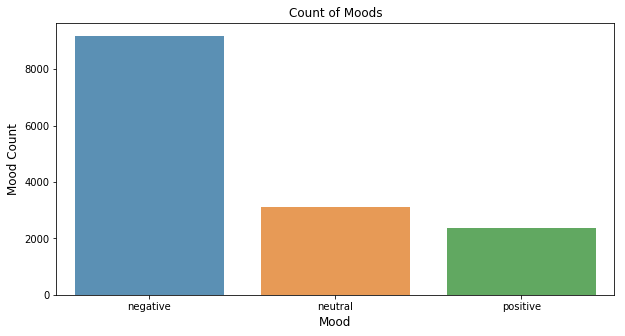

In [6]:
mood_count=df['airline_sentiment'].value_counts()
plt.figure(figsize=(10,5))
sns.barplot(mood_count.index, mood_count.values, alpha=0.8)
plt.title('Count of Moods')
plt.ylabel('Mood Count', fontsize=12)
plt.xlabel('Mood', fontsize=12)
plt.show()


In [7]:
for j in (mood_count.values):
    print(j/len(df)*100)

62.69125683060109
21.168032786885245
16.140710382513664


percentage of negativity is 62%
percentage of neutral is 21%
percentage of positive is 16%


It seems that negative mood dominates the passengers now let's dive deeper and see what causes the negativity the most

In [8]:
neg_reasons = df['negativereason'][df['airline_sentiment']=='negative'].value_counts()
neg_reasons

Customer Service Issue         2910
Late Flight                    1665
Can't Tell                     1190
Cancelled Flight                847
Lost Luggage                    724
Bad Flight                      580
Flight Booking Problems         529
Flight Attendant Complaints     481
longlines                       178
Damaged Luggage                  74
Name: negativereason, dtype: int64

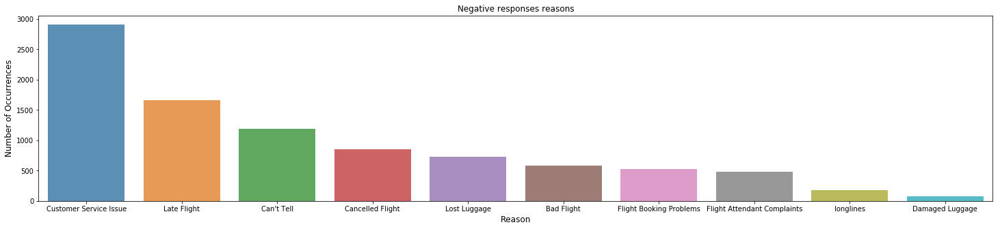

In [9]:
plt.figure(figsize=(25,5))
sns.barplot(neg_reasons.index, neg_reasons.values, alpha=0.8)
plt.title('Negative responses reasons')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Reason', fontsize=12)
plt.show()


In [10]:
df['user_timezone'].unique()

array(['Eastern Time (US & Canada)', 'Pacific Time (US & Canada)',
       'Central Time (US & Canada)', 'America/New_York',
       'Atlantic Time (Canada)', 'Quito', nan,
       'Mountain Time (US & Canada)', 'Vienna', 'Caracas', 'Kuala Lumpur',
       'Brisbane', 'Arizona', 'London', 'Tehran', 'Alaska', 'Sydney',
       'Irkutsk', 'Santiago', 'Amsterdam', 'Tijuana', 'Abu Dhabi',
       'Central America', 'Edinburgh', 'Jerusalem', 'Hawaii', 'Paris',
       'Guam', 'New Delhi', 'Stockholm', 'America/Chicago', 'Berlin',
       'Madrid', 'Athens', 'Brussels', 'Taipei', 'Rome', 'Beijing',
       'Mexico City', 'Bern', 'Singapore', 'Indiana (East)', 'Melbourne',
       'Saskatchewan', 'Casablanca', 'Brasilia', 'Kyiv', 'Bucharest',
       'Greenland', 'Prague', 'New Caledonia', 'Bogota', 'Seoul',
       'Sarajevo', 'Wellington', 'Bangkok', 'Warsaw', 'Copenhagen',
       'Hong Kong', 'Guadalajara', 'Mid-Atlantic', 'Mazatlan',
       'Buenos Aires', 'America/Los_Angeles', 'Dublin', 'Lisbon',
 

In [11]:
neg_timezone_count=df['user_timezone'][df['airline_sentiment']=='negative'].value_counts()[:10]
neg_timezone_count

Eastern Time (US & Canada)     2313
Central Time (US & Canada)     1191
Pacific Time (US & Canada)      720
Quito                           523
Atlantic Time (Canada)          299
Mountain Time (US & Canada)     226
Arizona                         135
London                          114
Alaska                           73
Hawaii                           62
Name: user_timezone, dtype: int64

> We can assume that the 1st three time zones are in The US to be able to plot them on a map to have a better prespective about where on the map the actual negative feedback is coming

In [12]:
neg_timezone_df = pd.DataFrame({'timezone':neg_timezone_count.index,'negative_count':neg_timezone_count.values})
neg_timezone_df.head(10)

,timezone,negative_count
0,Eastern Time (US & Canada),2313
1,Central Time (US & Canada),1191
2,Pacific Time (US & Canada),720
3,Quito,523
4,Atlantic Time (Canada),299
5,Mountain Time (US & Canada),226
6,Arizona,135
7,London,114
8,Alaska,73
9,Hawaii,62


We can assume that some close areas are belong to the same countries

In [13]:
for zone in neg_timezone_df['timezone']:
    if zone in ['Eastern Time (US & Canada)','Central Time (US & Canada)','Pacific Time (US & Canada)']:
        neg_timezone_df['timezone'][neg_timezone_df['timezone']==zone] = 'USA'
    if zone in ['Atlantic Time (Canada)','Mountain Time (US & Canada)']:
        neg_timezone_df['timezone'][neg_timezone_df['timezone']==zone] = 'Canada'
neg_timezone_df.head(10)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,timezone,negative_count
0,USA,2313
1,USA,1191
2,USA,720
3,Quito,523
4,Canada,299
5,Canada,226
6,Arizona,135
7,London,114
8,Alaska,73
9,Hawaii,62


In [14]:
neg_timezone_df = neg_timezone_df.groupby('timezone',as_index=True,sort=False).sum()

In [15]:
neg_timezone_df = neg_timezone_df.head(10)
latitude = ['37.0902','0.1807','56.1304','34.0489','51.5074','64.2008','19.8968']
longtuide = ['-95.7129','-78.4678','-106.3468','-111.0937','0.1278','-149.4937','-155.5828']
neg_timezone_df['latitude'] = latitude
neg_timezone_df['longtuide'] = longtuide

In [16]:
neg_timezone_df.head()

,negative_count,latitude,longtuide
timezone,,,
USA,4224,37.0902,-95.7129
Quito,523,0.1807,-78.4678
Canada,525,56.1304,-106.3468
Arizona,135,34.0489,-111.0937
London,114,51.5074,0.1278


In [17]:
neg_timezone_df['color']=neg_timezone_df['negative_count'].apply(lambda negative_count:"Black" if negative_count>=400 else
                                         "green" if negative_count>=300 and negative_count<400 else
                                         "Orange" if negative_count>=200 and negative_count<300 else
                                         "darkblue" if negative_count>=150 and negative_count<200 else
                                         "red" if negative_count>=100 and negative_count<150 else
                                         "lightblue" if negative_count>=75 and negative_count<100 else
                                         "brown" if negative_count>=50 and negative_count<75 else
                                         "grey")
neg_timezone_df['size']=neg_timezone_df['negative_count'].apply(lambda negative_count:20 if negative_count>=400 else
                                         15 if negative_count>=300 and negative_count<400 else
                                         12 if negative_count>=200 and negative_count<300 else
                                         11 if negative_count>=150 and negative_count<200 else
                                         10 if negative_count>=100 and negative_count<150 else
                                         7 if negative_count>=75 and negative_count<100 else
                                         5 if negative_count>=50 and negative_count<75 else
                                         3)

neg_timezone_df

,negative_count,latitude,longtuide,color,size
timezone,,,,,
USA,4224,37.0902,-95.7129,Black,20
Quito,523,0.1807,-78.4678,Black,20
Canada,525,56.1304,-106.3468,Black,20
Arizona,135,34.0489,-111.0937,red,10
London,114,51.5074,0.1278,red,10
Alaska,73,64.2008,-149.4937,brown,5
Hawaii,62,19.8968,-155.5828,brown,5


In [18]:
neg_timezone_df['timezone'] = neg_timezone_df.index

In [19]:
import folium
m=folium.Map([56.1304,106.3468],zoom_start=1)
#location=location[0:2000]
for lat,lon,area,color,count,size in zip(neg_timezone_df['latitude'],neg_timezone_df['longtuide'],neg_timezone_df['timezone'],neg_timezone_df['color'],neg_timezone_df['negative_count'],neg_timezone_df['size']):
     folium.CircleMarker([lat, lon],
                            popup=area,
                            radius=size,
                            color='b',
                            fill=True,
                            fill_opacity=0.7,
                            fill_color=color,
                           ).add_to(m)
m


Now it's clear that most of the negativity responses are coming from USA,Canada and Quito, although there's an error in latitude for USA and Canada but you got the idea of what I am after, now let's explore the moods for different airlines

In [20]:
df.head()

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,name,retweet_count,text,tweet_created,tweet_location,user_timezone
0,570306133677760513,neutral,1.0000,NaN,NaN,Virgin America,cairdin,0,@VirginAmerica What @dhepburn said.,2015-02-24 11:35:52 -0800,NaN,Eastern Time (US & Canada)
1,570301130888122368,positive,0.3486,NaN,0.0000,Virgin America,jnardino,0,@VirginAmerica plus you've added commercials t...,2015-02-24 11:15:59 -0800,NaN,Pacific Time (US & Canada)
2,570301083672813571,neutral,0.6837,NaN,NaN,Virgin America,yvonnalynn,0,@VirginAmerica I didn't today... Must mean I n...,2015-02-24 11:15:48 -0800,Lets Play,Central Time (US & Canada)
3,570301031407624196,negative,1.0000,Bad Flight,0.7033,Virgin America,jnardino,0,@VirginAmerica it's really aggressive to blast...,2015-02-24 11:15:36 -0800,NaN,Pacific Time (US & Canada)
4,570300817074462722,negative,1.0000,Can't Tell,1.0000,Virgin America,jnardino,0,@VirginAmerica and it's a really big bad thing...,2015-02-24 11:14:45 -0800,NaN,Pacific Time (US & Canada)


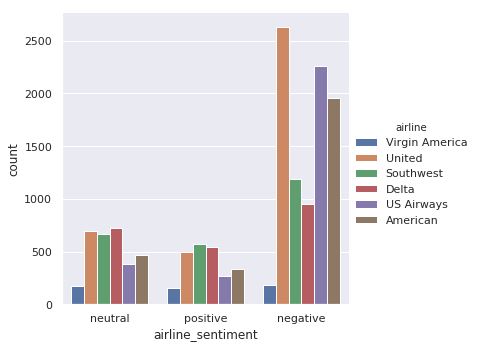

In [21]:
sns.set(rc={'figure.figsize':(10,20)})
sns.catplot(x='airline_sentiment',kind='count',data=df,orient="h",hue='airline')


As we can see most negative responses come from the United Airline, and most positive responses comes from Southwest airline

In [22]:
df['text_length'] =  list(map(lambda x:len(x),df['text']))

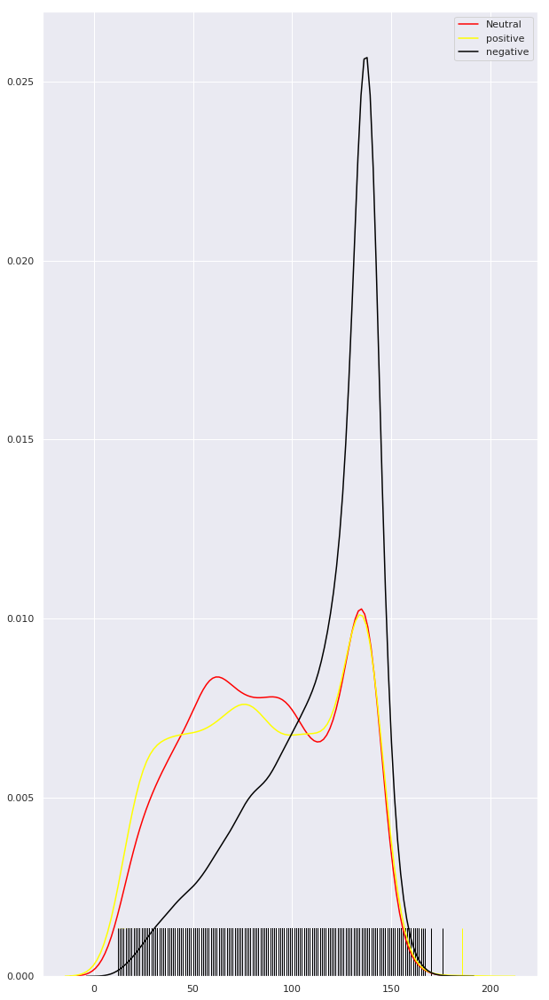

In [23]:
target_0 = df.loc[df['airline_sentiment'] == 'neutral']
target_1 = df.loc[df['airline_sentiment'] == 'positive']
target_2 = df.loc[df['airline_sentiment'] == 'negative']

sns.distplot(target_0[['text_length']], hist=False, rug=False,color='red',label='Neutral')
sns.distplot(target_1[['text_length']], hist=False, rug=True,color = 'yellow',label='positive')
sns.distplot(target_2[['text_length']], hist=False, rug=True,color='black',label='negative')

plt.show()


it's likely when the tweets is too long to be negative

## Let's now demonstrates some hypothesis tests on the data we have

In [24]:
df['text'].head(20)

0                   @VirginAmerica What @dhepburn said.
1     @VirginAmerica plus you've added commercials t...
2     @VirginAmerica I didn't today... Must mean I n...
3     @VirginAmerica it's really aggressive to blast...
4     @VirginAmerica and it's a really big bad thing...
5     @VirginAmerica seriously would pay $30 a fligh...
6     @VirginAmerica yes, nearly every time I fly VX...
7     @VirginAmerica Really missed a prime opportuni...
8       @virginamerica Well, I didn't…but NOW I DO! :-D
9     @VirginAmerica it was amazing, and arrived an ...
10    @VirginAmerica did you know that suicide is th...
11    @VirginAmerica I &lt;3 pretty graphics. so muc...
12    @VirginAmerica This is such a great deal! Alre...
13    @VirginAmerica @virginmedia I'm flying your #f...
14                               @VirginAmerica Thanks!
15        @VirginAmerica SFO-PDX schedule is still MIA.
16    @VirginAmerica So excited for my first cross c...
17    @VirginAmerica  I flew from NYC to SFO las

## Semantic Analysis


In [25]:
# Some initial features in text
qmarks = np.mean(df['text'].apply(lambda x: '?' in x))
exclamation = np.mean(df['text'].apply(lambda x: '!' in x))
at = np.mean(df['text'].apply(lambda x: '@' in x))
fullstop = np.mean(df['text'].apply(lambda x: '.' in x))
capital_first = np.mean(df['text'].apply(lambda x: x[0].isupper()))
capitals = np.mean(df['text'].apply(lambda x: max([y.isupper() for y in x])))
numbers = np.mean(df['text'].apply(lambda x: max([y.isdigit() for y in x])))
hashtags = np.mean(df['text'].apply(lambda x: '#' in x))

print('Tweets with question marks: {:.2f}%'.format(qmarks * 100))
print('Tweets with question hashtags: {:.2f}%'.format(hashtags * 100))
print('Tweets with exclamation marks: {:.2f}%'.format(exclamation * 100))
print('Tweets with full stops: {:.2f}%'.format(fullstop * 100))
print('Tweets with capitalised first letters: {:.2f}%'.format(capital_first * 100))
print('Tweets with capital letters: {:.2f}%'.format(capitals * 100))
print('Tweets with @: {:.2f}%'.format(at * 100))
print('Tweets with numbers: {:.2f}%'.format(numbers * 100))


Tweets with question marks: 25.10%
Tweets with question hashtags: 17.00%
Tweets with exclamation marks: 22.04%
Tweets with full stops: 66.41%
Tweets with capitalised first letters: 1.35%
Tweets with capital letters: 96.71%
Tweets with @: 100.00%
Tweets with numbers: 40.08%


### First hypothesis is tweets with question marks should be angrier 

In [26]:
df['has_question'] = df['text'].apply(lambda x: '?' in x)
df_has_question = df[df['has_question']]

In [27]:
df_has_question.head()

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,name,retweet_count,text,tweet_created,tweet_location,user_timezone,text_length,has_question
19,570267956648792064,positive,1.0000,NaN,NaN,Virgin America,JNLpierce,0,@VirginAmerica you know what would be amazingl...,2015-02-24 09:04:10 -0800,Boston | Waltham,Quito,107,True
20,570265883513384960,negative,0.6705,Can't Tell,0.3614,Virgin America,MISSGJ,0,@VirginAmerica why are your first fares in May...,2015-02-24 08:55:56 -0800,NaN,NaN,130,True
23,570258822297579520,neutral,1.0000,NaN,NaN,Virgin America,rjlynch21086,0,@VirginAmerica will you be making BOS&gt;LAS n...,2015-02-24 08:27:52 -0800,"Boston, MA",Eastern Time (US & Canada),79,True
26,570239632807370753,negative,1.0000,Can't Tell,0.6614,Virgin America,meredithjlynn,0,@VirginAmerica What happened 2 ur vegan food o...,2015-02-24 07:11:37 -0800,NaN,NaN,140,True
27,570217831557677057,neutral,0.6854,NaN,NaN,Virgin America,AdamSinger,0,@VirginAmerica do you miss me? Don't worry we'...,2015-02-24 05:44:59 -0800,"San Francisco, CA",Central Time (US & Canada),71,True


In [28]:
df_has_question.airline_sentiment.value_counts()

negative    2377
neutral     1195
positive     103
Name: airline_sentiment, dtype: int64

In [29]:
for j in (df_has_question.airline_sentiment.value_counts().values):
    print(j/len(df_has_question)*100)

64.68027210884354
32.517006802721085
2.802721088435374


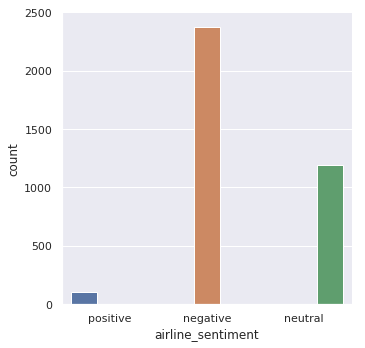

In [30]:
sns.catplot(x='airline_sentiment',kind='count',data=df_has_question,orient="h",hue='airline_sentiment')


So our benchmark on the unfiltered dataset was.

> Negative = 62.69125683060109 %

> Neutral = 21.168032786885245 %

> Postive = 16.140710382513664 %





As you can see the percentage of positivity for the tweet decreased tremendously and the neutral percentage increased, So we can conclude that adding '!' to the tweets increased the probability of it being neutral or negative

### Let's validate this assumption

### First Approach

Fit logestic regression model having X as has_question feature and Y(label) as airline_sentiment

In [31]:
df_hasquestion = df[['has_question','airline_sentiment']]

In [32]:
df_hasquestion.head()

,has_question,airline_sentiment
0,False,neutral
1,False,positive
2,False,neutral
3,False,negative
4,False,negative


In [33]:
df_hasquestion['has_question'] = [1 if df_hasquestion['has_question'][x] == True else 0 for x in range(len(df_hasquestion['has_question']))]

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [34]:
df_hasquestion['airline_sentiment'] = [1 if df_hasquestion['airline_sentiment'][x] == 'positive' else 0 for x in range(len(df_hasquestion['airline_sentiment']))]

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [35]:
x = np.array(df_hasquestion['has_question'])
y = np.array(df_hasquestion['airline_sentiment'])

In [36]:
x=x.reshape(-1,1)

In [37]:
from sklearn.linear_model import LogisticRegression
clf = LogisticRegression(solver='liblinear',random_state=0).fit(x,y)


In [38]:
from scipy import stats

params = np.append(clf.intercept_,clf.coef_)
predictions = clf.predict(x)
newX = pd.DataFrame({"Constant":np.ones(len(x))}).join(pd.DataFrame(x))
MSE = (sum((y-predictions)**2))/(len(newX)-len(newX.columns))

var_b = MSE*(np.linalg.inv(np.dot(newX.T,newX)).diagonal())
sd_b = np.sqrt(var_b)
ts_b = params/ sd_b

p_values =[2*(1-stats.t.cdf(np.abs(i),(len(newX)-1))) for i in ts_b]
sd_b = np.round(sd_b,3)
ts_b = np.round(ts_b,3)
p_values = np.round(p_values,)
params = np.round(params,4)

myDF3 = pd.DataFrame()
myDF3["Coefficients"],myDF3["Standard Errors"],myDF3["t values"],myDF3["Probabilites"] = [params,sd_b,ts_b,p_values]
print(myDF3)


   Coefficients  Standard Errors  t values  Probabilites
0       -1.3490            0.004  -351.579           0.0
1       -2.1753            0.008  -284.043           0.0


So as you can see the probability for a given beta is 0.000 so their is a very small room for error so the we can now accept our hypothesis 


### Second approach

The second approach we will be taking here is that we compute an unpaired T-test between samples from data that do have question mark and samples that do not have a question mark in the text field and see the p value for the predictor 'has_question'

In [39]:
df_hasquestion = df[df['has_question']==True]
df_hasnotques = df[df['has_question']==False]

In [40]:
print(len(df_hasquestion))
print(len(df_hasnotques))

3675
10965


In [41]:
sample1 = df_hasquestion.sample(n=1000,random_state= 1)
sample2 = df_hasnotques.sample(n=1000, random_state = 1)

In [42]:
print(len(sample1))
print(len(sample2))

1000
1000


In [43]:
var_a = sample1.var(ddof=1)
var_b = sample2.var(ddof=1)


In [44]:
var_a

tweet_id                        6.053734e+29
airline_sentiment_confidence    2.633133e-02
negativereason_confidence       1.186518e-01
retweet_count                   2.039940e+00
text_length                     1.031450e+03
has_question                    0.000000e+00
dtype: float64

In [45]:
var_b

tweet_id                        6.151969e+29
airline_sentiment_confidence    2.682094e-02
negativereason_confidence       1.034453e-01
retweet_count                   3.386897e-01
text_length                     1.361402e+03
has_question                    0.000000e+00
dtype: float64

In [46]:
#std deviation
s = np.sqrt((var_a + var_b)/2)


In [47]:
s

tweet_id                        7.812075e+14
airline_sentiment_confidence    1.630219e-01
negativereason_confidence       3.332395e-01
retweet_count                   1.090557e+00
text_length                     3.458940e+01
has_question                    0.000000e+00
dtype: float64

In [48]:
## Calculate the t-statistics
t = (sample1.mean() - sample2.mean())/(s*np.sqrt(2/1000))
## Compare with the critical t-value
#Degrees of freedom
deg_f = 2*1000 - 2

#p-value after comparison with the t 
p = 1 - stats.t.cdf(t,df=deg_f)


print("t = " + str(t))
print("p = " + str(2*p))

t = tweet_id                        0.629708
airline_sentiment_confidence   -1.092852
negativereason_confidence      -1.703657
retweet_count                   0.348566
text_length                     3.676421
has_question                         inf
dtype: float64
p = [5.28957399e-01 1.72540927e+00 1.91139933e+00 7.27451588e-01
 2.42771321e-04 0.00000000e+00]


As you can see the p value for the predictor 'has question' is equal to zero so we can now be certain about our assumption

### Second hypothesis is tweets with full stops should be neutral

In [49]:
df['has_fullstops'] = df['text'].apply(lambda x: '.' in x)


In [50]:
df_has_fullstops = df[df['has_fullstops']]

In [51]:
for j in (df_has_fullstops.airline_sentiment.value_counts().values):
    print(j/len(df_has_fullstops)*100)

67.56145222667901
17.782577393808495
14.655970379512496


So our benchmark on the unfiltered dataset was.

> Negative = 62.69125683060109 %

> Neutral = 21.168032786885245 %

> Postive = 16.140710382513664 %





As you can see the percentage didn't change much so having a full stop in the text didn't actually affect the nature of the tweets

### Let's do a test to see whether having digits in the tweet really affect it's sentiment

In [52]:
df['has_digits'] = df['text'].apply(lambda x: max([y.isdigit() for y in x]))


In [53]:
df_hasdigit=df[df['has_digits']]

In [54]:
for j in (df_hasdigit.airline_sentiment.value_counts().values):
    print(j/len(df_hasdigit)*100)

69.68302658486708
20.245398773006134
10.071574642126789


Not much changes in the percenatges so we concluded that digits doesn't affect the sentiment of the tweets

## WordClouds 
One very handy visualization tool for a data scientist when it comes to any sort of natural language processing is plotting "Word Cloud". A word cloud (as the name suggests) is an image that is made up of a mixture of distinct words which may make up a text or book and where the size of each word is proportional to its word frequency in that text (number of times the word appears)

### Wordcloud for negative sentiment

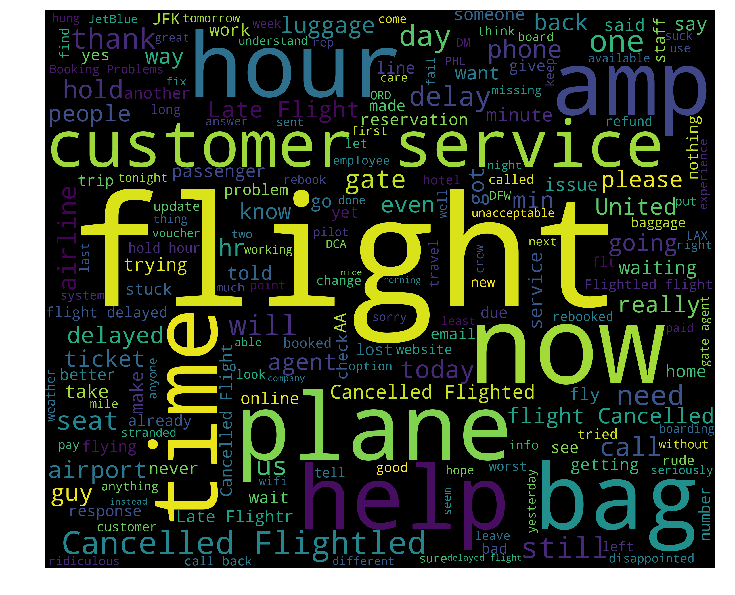

In [55]:
from wordcloud import WordCloud,STOPWORDS
df_x=df[df['airline_sentiment']=='negative']
words = ' '.join(df_x['text'].values)
cleaned_word = " ".join([word for word in words.split()
                            if 'http' not in word
                                and not word.startswith('@')
                                and word != 'RT'
                            ])
wordcloud = WordCloud(stopwords=STOPWORDS,
                      background_color='black',
                      width=3000,
                      height=2500
                     ).generate(cleaned_word)

plt.figure(1,figsize=(12, 20))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()


As we may presume the most frequent words would be people complaining about flight canncellation, customer service and bags issues as appeared in the word cloud for negative responses, no clean text for positive and neutral responses to generate wordcloud for them. We can go deeper and computer the actual TFIDF weight for each word, let's see how can we do that.


In [56]:
def get_weight(count, eps=10000, min_count=2):
    if count < min_count:
        return 0
    else:
        return 1 / (count + eps)


In [57]:
import re
import nltk
from nltk.corpus import stopwords

def tweet_to_words(raw_tweet):
    letters_only = re.sub("[^a-zA-Z]", " ",raw_tweet) 
    words = letters_only.lower().split()                             
    stops = set(stopwords.words("english"))                  
    meaningful_words = [w for w in words if not w in stops] 
    return( " ".join( meaningful_words )) 


In [58]:
df['clean_text']=df['text'].apply(lambda x: tweet_to_words(x))


In [59]:
df.clean_text[:5]

0                          virginamerica dhepburn said
1    virginamerica plus added commercials experienc...
2    virginamerica today must mean need take anothe...
3    virginamerica really aggressive blast obnoxiou...
4                   virginamerica really big bad thing
Name: clean_text, dtype: object

In [60]:
from collections import Counter
words = (" ".join(df.clean_text)).lower().split()
counts = Counter(words)
weights = {word: get_weight(count) for word, count in counts.items()}


In [61]:
print('Most common words and weights: \n')
print(sorted(weights.items(), key=lambda x: x[1] if x[1] > 0 else 9999)[:10])
print('\nLeast common words and weights: ')
(sorted(weights.items(), key=lambda x: x[1], reverse=True)[:10])


Most common words and weights: 

[('united', 7.058657443354274e-05), ('flight', 7.164350193437455e-05), ('usairways', 7.661074082586379e-05), ('americanair', 7.71366862079605e-05), ('southwestair', 8.025038118931065e-05), ('jetblue', 8.067118425298483e-05), ('get', 8.816787162757891e-05), ('co', 8.917424647761727e-05), ('http', 8.964589870013447e-05), ('thanks', 9.022827754218172e-05)]

Least common words and weights: 


[('blast', 9.998000399920016e-05),
 ('obnoxious', 9.998000399920016e-05),
 ('ear', 9.998000399920016e-05),
 ('gentleman', 9.998000399920016e-05),
 ('amazingly', 9.998000399920016e-05),
 ('ut', 9.998000399920016e-05),
 ('permanently', 9.998000399920016e-05),
 ('maneuver', 9.998000399920016e-05),
 ('fe', 9.998000399920016e-05),
 ('vibe', 9.998000399920016e-05)]

let's convert our labels , negative/neutral/positive to numbers to be able to see the correlation betwwen different features and those labels, 

In [62]:
df['sentiment']=df['airline_sentiment'].apply(lambda x: 0 if x=='negative' else 1)


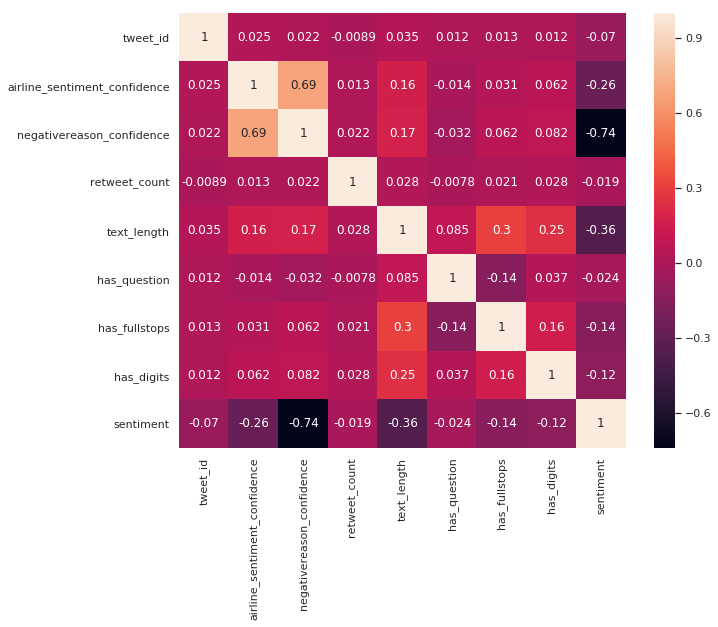

In [63]:
corr=df.corr()
plt.figure(figsize=(10,8))
sns.heatmap(corr,
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values, annot=True)


Let's begin preparaing our data for ML pipeline so first step is that we should vecotrize the text we have in the tweets data. We have seen a type of vectorization the TFIDF when we gave weights to each word remeber? SKLearn got us covered in this issue we lots of vectorizing techniques and we will explore them one by one!

***CountVectorizer*
**
Creates a matrix with frequency counts of each word in the text corpus


***TF-IDF Vectorizer*
****TF - Term Frequency -- Count of the words(Terms) in the text corpus (same of Count Vect)
IDF - Inverse Document Frequency -- Penalizes words that are too frequent. We can think of this as regularization


***HashingVectorizer***
Creates a hashmap(word to number mapping based on hashing technique) instead of a dictionary for vocabulary
This enables it to be more scalable and faster for larger text coprus
Can be parallelized across multiple threads

In [64]:
df.head()

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,name,retweet_count,text,tweet_created,tweet_location,user_timezone,text_length,has_question,has_fullstops,has_digits,clean_text,sentiment
0,570306133677760513,neutral,1.0000,NaN,NaN,Virgin America,cairdin,0,@VirginAmerica What @dhepburn said.,2015-02-24 11:35:52 -0800,NaN,Eastern Time (US & Canada),35,False,True,False,virginamerica dhepburn said,1
1,570301130888122368,positive,0.3486,NaN,0.0000,Virgin America,jnardino,0,@VirginAmerica plus you've added commercials t...,2015-02-24 11:15:59 -0800,NaN,Pacific Time (US & Canada),72,False,True,False,virginamerica plus added commercials experienc...,1
2,570301083672813571,neutral,0.6837,NaN,NaN,Virgin America,yvonnalynn,0,@VirginAmerica I didn't today... Must mean I n...,2015-02-24 11:15:48 -0800,Lets Play,Central Time (US & Canada),71,False,True,False,virginamerica today must mean need take anothe...,1
3,570301031407624196,negative,1.0000,Bad Flight,0.7033,Virgin America,jnardino,0,@VirginAmerica it's really aggressive to blast...,2015-02-24 11:15:36 -0800,NaN,Pacific Time (US & Canada),126,False,False,False,virginamerica really aggressive blast obnoxiou...,0
4,570300817074462722,negative,1.0000,Can't Tell,1.0000,Virgin America,jnardino,0,@VirginAmerica and it's a really big bad thing...,2015-02-24 11:14:45 -0800,NaN,Pacific Time (US & Canada),55,False,False,False,virginamerica really big bad thing,0


In [65]:
from sklearn.model_selection import train_test_split
train,test = train_test_split(df,test_size=0.2,random_state=42)



**Check data balance**

In [66]:
train.sentiment.value_counts()

0    7289
1    4423
Name: sentiment, dtype: int64

Unbalaced datasets could cause problems to our model and bias it to a wrong directions 

In [67]:
pos_train = train[train['sentiment']==1]
neg_train = train[train['sentiment']==0]

In [68]:
print(len(pos_train))
print(len(neg_train))

4423
7289


In [69]:
pd.concat([pos_train,pos_train])

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,name,retweet_count,text,tweet_created,tweet_location,user_timezone,text_length,has_question,has_fullstops,has_digits,clean_text,sentiment
7598,569516908195815425,positive,0.6671,NaN,0.0,Delta,djkeating13,0,"@JetBlue well, the last update was in the righ...",2015-02-22 07:19:46 -0800,"Malden, MA",Eastern Time (US & Canada),98,False,True,False,jetblue well last update right direction least...,1
6187,568147483269971969,neutral,0.6883,NaN,0.0,Southwest,Brian_Fox,0,@southwestair is your companion pass broken to...,2015-02-18 12:38:10 -0800,"NH, United States",Eastern Time (US & Canada),138,True,True,True,southwestair companion pass broken today purch...,1
2264,569287433008754688,positive,1.0000,NaN,NaN,United,michaelmcd,0,@united that's great! pls let me know when u s...,2015-02-21 16:07:55 -0800,Beijing | Los Angeles,Beijing,51,False,False,False,united great pls let know u start,1
10415,569322901691707392,neutral,0.6667,NaN,0.0,US Airways,KitchenRecess,0,@USAirways Don't want to clog your already-cro...,2015-02-21 18:28:51 -0800,NaN,NaN,138,True,True,False,usairways want clog already crowded line speci...,1
8291,568527764812374016,neutral,0.6723,NaN,0.0,Delta,beantoon,0,@JetBlue what is the Mosiac 800 #?,2015-02-19 13:49:16 -0800,"Plymouth, MA",NaN,34,True,False,True,jetblue mosiac,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466,567813046811525120,positive,0.6803,NaN,NaN,Virgin America,SimplyImplicit,0,@VirginAmerica I don’t use Passbook =/ I still...,2015-02-17 14:29:14 -0800,"Los Angeles, CA",Central Time (US & Canada),109,False,True,True,virginamerica use passbook still love though l...,1
6265,568087614303166464,neutral,1.0000,NaN,NaN,Southwest,COIAerospace,0,@SouthwestAir is offering #CompanionPasses to ...,2015-02-18 08:40:16 -0800,"Atlanta, Georgia",Eastern Time (US & Canada),102,False,True,True,southwestair offering companionpasses atlanta ...,1
5734,568768874037915648,neutral,0.6426,NaN,0.0,Southwest,patrickisarobot,0,@SouthwestAir I would love to go to the #Desti...,2015-02-20 05:47:21 -0800,In my mind,Mountain Time (US & Canada),139,False,True,False,southwestair would love go destinationdragons ...,1
5191,569266206596734976,positive,1.0000,NaN,NaN,Southwest,LRBurbs,0,@SouthwestAir replacing @vitaminwater with bee...,2015-02-21 14:43:34 -0800,chicago,Central Time (US & Canada),101,False,False,False,southwestair replacing vitaminwater beer bravo...,1


In [70]:
x_train = train['clean_text']
y_train = train['sentiment']
x_test = test['clean_text']
y_test = test['sentiment']

In [71]:
train_clean_tweet=[]
for tweet in x_train:
    train_clean_tweet.append(tweet)
test_clean_tweet=[]
for tweet in x_test:
    test_clean_tweet.append(tweet)
y = y_train

## CountVector

In [72]:
from sklearn.feature_extraction.text import CountVectorizer
v = CountVectorizer(analyzer = "word")
train_features= v.fit_transform(train_clean_tweet)
test_features=v.transform(test_clean_tweet)


In [73]:
# See the words contained in our data
print(v.get_feature_names())

['aa', 'aaaand', 'aaadvantage', 'aaalwayslate', 'aadavantage', 'aadelay', 'aadv', 'aadvantage', 'aafail', 'aakjumxa', 'aal', 'aarp', 'aateam', 'aau', 'aavvoreph', 'aay', 'ab', 'aback', 'abandon', 'abandoned', 'abandonment', 'abassinet', 'abbreve', 'abc', 'abcnetwork', 'abcnews', 'abi', 'abigailedge', 'abilities', 'ability', 'able', 'aboard', 'aboout', 'abounds', 'abprg', 'abq', 'abroad', 'absolute', 'absolutely', 'absorb', 'absorber', 'absoulutely', 'absurd', 'absurdity', 'absurdly', 'abt', 'abtwf', 'abundance', 'abuse', 'abused', 'abysmal', 'ac', 'acc', 'accelerate', 'accept', 'acceptable', 'accepted', 'accepting', 'access', 'accessibility', 'accessible', 'accessing', 'accident', 'accidentally', 'accidents', 'accomidating', 'accommodate', 'accommodated', 'accommodates', 'accommodating', 'accommodation', 'accommodations', 'accomplish', 'accomplished', 'according', 'accordingly', 'account', 'accountability', 'accountable', 'accounts', 'accrue', 'accruing', 'acct', 'accts', 'accumulation

In [74]:
import sys
import numpy
numpy.set_printoptions(threshold=sys.maxsize)
# see the vector of the second word for example
print(train_features.toarray()[1:3
                              ])

[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

In [75]:
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC, LinearSVC, NuSVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.metrics import accuracy_score
import xgboost as xgb
Classifiers = [
    LogisticRegression(C=0.000000001,solver='liblinear',max_iter=200),
    KNeighborsClassifier(3),
    SVC(kernel="rbf", C=0.025, probability=True),
    DecisionTreeClassifier(),
    RandomForestClassifier(n_estimators=200),
    AdaBoostClassifier(),
    GaussianNB(),
    xgb.XGBClassifier(max_depth=7, n_estimators=200, colsample_bytree=0.8, 
                        subsample=0.8, nthread=10, learning_rate=0.1)
]


In [76]:
dense_features=train_features.toarray()
dense_test= test_features.toarray()
Accuracy=[]
Model=[]
for classifier in Classifiers:
    try:
        fit = classifier.fit(train_features,train['sentiment'])
        pred = fit.predict(test_features)
    except Exception:
        fit = classifier.fit(dense_features,train['sentiment'])
        pred = fit.predict(dense_test)
    accuracy = accuracy_score(pred,test['sentiment'])
    Accuracy.append(accuracy)
    Model.append(classifier.__class__.__name__)
    print('Accuracy of '+classifier.__class__.__name__+'is '+str(accuracy))    


Accuracy of LogisticRegressionis 0.6451502732240437
Accuracy of KNeighborsClassifieris 0.5891393442622951


/opt/conda/lib/python3.6/site-packages/sklearn/svm/base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)


Accuracy of SVCis 0.6451502732240437
Accuracy of DecisionTreeClassifieris 0.7581967213114754
Accuracy of RandomForestClassifieris 0.8176229508196722
Accuracy of AdaBoostClassifieris 0.7855191256830601
Accuracy of GaussianNBis 0.5724043715846995
Accuracy of XGBClassifieris 0.8145491803278688


So we got Random forest classifier is slightly above the bare random guessing so let's try antoher approach to mitigate the problem of unbalanced dataset, let's keep the data as is without scalling and measure precision and recall 
recall = true positives/ true positives + false negatives

> You might notice something about this equation: if we label all data pts as postives, then our recall goes to 1.0! We have a perfect classifier right?
Well, not exactly. As with most concepts in data science, there is a trade-off in the metrics we choose to maximize. In the case of recall, when we increase the recall, we decrease the precision, so in order be confident in our model dicisions we need to account on both metrics
precision = true positives / true positives + false positives


In [77]:
train_clean_tweet=[]
for tweet in train['clean_text']:
    train_clean_tweet.append(tweet)
test_clean_tweet=[]
for tweet in test['clean_text']:
    test_clean_tweet.append(tweet)
y = train['sentiment']

In [78]:
v = CountVectorizer(analyzer = "word")
train_features= v.fit_transform(x_train)
test_features=v.transform(x_test)


In [79]:
from sklearn.metrics import average_precision_score
from sklearn.metrics import classification_report


In [80]:
dense_features=train_features.toarray()
dense_test= test_features.toarray()
Accuracy=[]
Model=[]
for classifier in Classifiers:
    try:
        fit = classifier.fit(train_features,y_train)
        pred = fit.predict(test_features)
    except Exception:
        fit = classifier.fit(dense_features,y_train)
        pred = fit.predict(dense_test)
    accuracy = accuracy_score(pred,y_test)
    average_precision = average_precision_score(pred,y_test)
    class_rep = classification_report(pred,y_test)
    Accuracy.append(accuracy)
    Model.append(classifier.__class__.__name__)
    print('Accuracy of '+classifier.__class__.__name__+'is '+str(accuracy))
    print('Average precision-recall score: {0:0.2f}'.format(
      average_precision))
    print('classification report: '+str(class_rep))
    



/opt/conda/lib/python3.6/site-packages/sklearn/metrics/ranking.py:528: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


Accuracy of LogisticRegressionis 0.6451502732240437
Average precision-recall score: nan
classification report:               precision    recall  f1-score   support

           0       1.00      0.65      0.78      2928
           1       0.00      0.00      0.00         0

    accuracy                           0.65      2928
   macro avg       0.50      0.32      0.39      2928
weighted avg       1.00      0.65      0.78      2928

Accuracy of KNeighborsClassifieris 0.5891393442622951
Average precision-recall score: 0.74
classification report:               precision    recall  f1-score   support

           0       0.45      0.84      0.58      1004
           1       0.85      0.46      0.59      1924

    accuracy                           0.59      2928
   macro avg       0.65      0.65      0.59      2928
weighted avg       0.71      0.59      0.59      2928



/opt/conda/lib/python3.6/site-packages/sklearn/svm/base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/ranking.py:528: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


Accuracy of SVCis 0.6451502732240437
Average precision-recall score: nan
classification report:               precision    recall  f1-score   support

           0       1.00      0.65      0.78      2928
           1       0.00      0.00      0.00         0

    accuracy                           0.65      2928
   macro avg       0.50      0.32      0.39      2928
weighted avg       1.00      0.65      0.78      2928

Accuracy of DecisionTreeClassifieris 0.762636612021858
Average precision-recall score: 0.56
classification report:               precision    recall  f1-score   support

           0       0.82      0.82      0.82      1890
           1       0.67      0.67      0.67      1038

    accuracy                           0.76      2928
   macro avg       0.74      0.74      0.74      2928
weighted avg       0.76      0.76      0.76      2928

Accuracy of RandomForestClassifieris 0.8142076502732241
Average precision-recall score: 0.62
classification report:               preci

Unfortunately, there is no built-in lemmatizer in the vectorizer so we are left with a couple of options. Either implementing it separately everytime before feeding the data for vectorizing or somehow extend the sklearn implementation to include this functionality. Luckily for us, we have the latter option where we can extend the CountVectorizer class by overwriting the "build_analyzer" method as follows:

let's try to extending the CountVectorizer class with a lemmatizer and try again fitting our models


## Lemmatization + Countvector

In [81]:
from nltk.stem import WordNetLemmatizer
lemm = WordNetLemmatizer()
class LemmaCountVectorizer(CountVectorizer):
    def build_analyzer(self):
        analyzer = super(LemmaCountVectorizer, self).build_analyzer()
        return lambda doc: (lemm.lemmatize(w) for w in analyzer(doc))


In [82]:
tf_vectorizer = LemmaCountVectorizer(max_df=0.95, 
                                     min_df=2,
                                     stop_words='english',
                                     decode_error='ignore')
train_features= tf_vectorizer.fit_transform(x_train)
test_features=tf_vectorizer.transform(x_test)
dense_features=train_features.toarray()
dense_test= test_features.toarray()
Accuracy=[]
Model=[]
for classifier in Classifiers:
    try:
        fit = classifier.fit(train_features,y_train)
        pred = fit.predict(test_features)
    except Exception:
        fit = classifier.fit(dense_features,y_train)
        pred = fit.predict(dense_test)
    accuracy = accuracy_score(pred,y_test)
    average_precision = average_precision_score(pred, y_test)
    class_rep = classification_report(pred,y_test)
    Accuracy.append(accuracy)
    Model.append(classifier.__class__.__name__)
    print('Accuracy of '+classifier.__class__.__name__+'is '+str(accuracy))
    print('Average precision-recall score: {0:0.2f}'.format(
      average_precision))
    print('classification report: '+str(class_rep))




/opt/conda/lib/python3.6/site-packages/sklearn/metrics/ranking.py:528: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


Accuracy of LogisticRegressionis 0.6451502732240437
Average precision-recall score: nan
classification report:               precision    recall  f1-score   support

           0       1.00      0.65      0.78      2928
           1       0.00      0.00      0.00         0

    accuracy                           0.65      2928
   macro avg       0.50      0.32      0.39      2928
weighted avg       1.00      0.65      0.78      2928

Accuracy of KNeighborsClassifieris 0.5884562841530054
Average precision-recall score: 0.76
classification report:               precision    recall  f1-score   support

           0       0.43      0.86      0.58       954
           1       0.87      0.46      0.60      1974

    accuracy                           0.59      2928
   macro avg       0.65      0.66      0.59      2928
weighted avg       0.73      0.59      0.59      2928



/opt/conda/lib/python3.6/site-packages/sklearn/svm/base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/ranking.py:528: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


Accuracy of SVCis 0.6451502732240437
Average precision-recall score: nan
classification report:               precision    recall  f1-score   support

           0       1.00      0.65      0.78      2928
           1       0.00      0.00      0.00         0

    accuracy                           0.65      2928
   macro avg       0.50      0.32      0.39      2928
weighted avg       1.00      0.65      0.78      2928

Accuracy of DecisionTreeClassifieris 0.7448770491803278
Average precision-recall score: 0.58
classification report:               precision    recall  f1-score   support

           0       0.77      0.82      0.80      1770
           1       0.70      0.63      0.66      1158

    accuracy                           0.74      2928
   macro avg       0.73      0.72      0.73      2928
weighted avg       0.74      0.74      0.74      2928

Accuracy of RandomForestClassifieris 0.8049863387978142
Average precision-recall score: 0.62
classification report:               prec

This got us a slight improvement on the precision-recall scale

## TFIDF

In [83]:
from sklearn.feature_extraction.text import TfidfVectorizer


In [84]:
tfv = TfidfVectorizer(min_df=3,  max_features=None, 
            strip_accents='unicode', analyzer='word',token_pattern=r'\w{1,}',
            ngram_range=(1, 3), use_idf=1,smooth_idf=1,sublinear_tf=1,
            stop_words = 'english')
train_features= tfv.fit_transform(x_train)
test_features=tfv.transform(x_test)
dense_features=train_features.toarray()
dense_test= test_features.toarray()
Accuracy=[]
Model=[]
for classifier in Classifiers:
    try:
        fit = classifier.fit(train_features,y_train)
        pred = fit.predict(test_features)
    except Exception:
        fit = classifier.fit(dense_features,y_train)
        pred = fit.predict(dense_test)
    accuracy = accuracy_score(pred,y_test)
    average_precision = average_precision_score(pred, y_test)
    class_rep = classification_report(pred,y_test)
    Accuracy.append(accuracy)
    Model.append(classifier.__class__.__name__)
    print('Accuracy of '+classifier.__class__.__name__+'is '+str(accuracy))
    print('Average precision-recall score: {0:0.2f}'.format(
      average_precision))
    print('classification report: '+str(class_rep))


/opt/conda/lib/python3.6/site-packages/sklearn/metrics/ranking.py:528: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


Accuracy of LogisticRegressionis 0.6451502732240437
Average precision-recall score: nan
classification report:               precision    recall  f1-score   support

           0       1.00      0.65      0.78      2928
           1       0.00      0.00      0.00         0

    accuracy                           0.65      2928
   macro avg       0.50      0.32      0.39      2928
weighted avg       1.00      0.65      0.78      2928

Accuracy of KNeighborsClassifieris 0.7281420765027322
Average precision-recall score: 0.60
classification report:               precision    recall  f1-score   support

           0       0.73      0.83      0.78      1675
           1       0.72      0.60      0.65      1253

    accuracy                           0.73      2928
   macro avg       0.73      0.71      0.71      2928
weighted avg       0.73      0.73      0.72      2928



/opt/conda/lib/python3.6/site-packages/sklearn/svm/base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/ranking.py:528: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


Accuracy of SVCis 0.6451502732240437
Average precision-recall score: nan
classification report:               precision    recall  f1-score   support

           0       1.00      0.65      0.78      2928
           1       0.00      0.00      0.00         0

    accuracy                           0.65      2928
   macro avg       0.50      0.32      0.39      2928
weighted avg       1.00      0.65      0.78      2928

Accuracy of DecisionTreeClassifieris 0.7264344262295082
Average precision-recall score: 0.56
classification report:               precision    recall  f1-score   support

           0       0.76      0.81      0.78      1780
           1       0.67      0.60      0.63      1148

    accuracy                           0.73      2928
   macro avg       0.71      0.70      0.71      2928
weighted avg       0.72      0.73      0.72      2928

Accuracy of RandomForestClassifieris 0.8073770491803278
Average precision-recall score: 0.60
classification report:               prec

In [85]:
tfv = TfidfVectorizer(min_df=3,  max_features=None, 
            strip_accents='unicode', analyzer='word',
             use_idf=1,smooth_idf=1,sublinear_tf=1,
            stop_words = 'english')
train_features= tfv.fit_transform(x_train)
test_features=tfv.transform(x_test)


In [86]:

dense_features=train_features.toarray()
dense_test= test_features.toarray()
Accuracy=[]
Model=[]
for classifier in Classifiers:
    try:
        fit = classifier.fit(train_features,y_train)
        pred = fit.predict(test_features)
    except Exception:
        fit = classifier.fit(dense_features,y_train)
        pred = fit.predict(dense_test)
    accuracy = accuracy_score(pred,y_test)
    average_precision = average_precision_score(pred, y_test)
    class_rep = classification_report(pred,y_test)
    Accuracy.append(accuracy)
    Model.append(classifier.__class__.__name__)
    print('Accuracy of '+classifier.__class__.__name__+'is '+str(accuracy))
    print('Average precision-recall score: {0:0.2f}'.format(
      average_precision))
    print('classification report: '+str(class_rep))


/opt/conda/lib/python3.6/site-packages/sklearn/metrics/ranking.py:528: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


Accuracy of LogisticRegressionis 0.6451502732240437
Average precision-recall score: nan
classification report:               precision    recall  f1-score   support

           0       1.00      0.65      0.78      2928
           1       0.00      0.00      0.00         0

    accuracy                           0.65      2928
   macro avg       0.50      0.32      0.39      2928
weighted avg       1.00      0.65      0.78      2928

Accuracy of KNeighborsClassifieris 0.7209699453551912
Average precision-recall score: 0.63
classification report:               precision    recall  f1-score   support

           0       0.70      0.84      0.76      1584
           1       0.75      0.58      0.66      1344

    accuracy                           0.72      2928
   macro avg       0.73      0.71      0.71      2928
weighted avg       0.73      0.72      0.72      2928



/opt/conda/lib/python3.6/site-packages/sklearn/svm/base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/ranking.py:528: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


Accuracy of SVCis 0.6451502732240437
Average precision-recall score: nan
classification report:               precision    recall  f1-score   support

           0       1.00      0.65      0.78      2928
           1       0.00      0.00      0.00         0

    accuracy                           0.65      2928
   macro avg       0.50      0.32      0.39      2928
weighted avg       1.00      0.65      0.78      2928

Accuracy of DecisionTreeClassifieris 0.7165300546448088
Average precision-recall score: 0.55
classification report:               precision    recall  f1-score   support

           0       0.75      0.80      0.77      1775
           1       0.66      0.59      0.62      1153

    accuracy                           0.72      2928
   macro avg       0.70      0.69      0.70      2928
weighted avg       0.71      0.72      0.71      2928

Accuracy of RandomForestClassifieris 0.8097677595628415
Average precision-recall score: 0.59
classification report:               prec

## TF-IDF + SVD

In [87]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD
svd = TruncatedSVD(n_components=120)
svd.fit(train_features)
xtrain_svd = svd.transform(train_features)
xvalid_svd = svd.transform(test_features)

# Scale the data obtained from SVD. Renaming variable to reuse without scaling.
scl = StandardScaler()
scl.fit(xtrain_svd)
xtrain_svd_scl = scl.transform(xtrain_svd)
xvalid_svd_scl = scl.transform(xvalid_svd)


In [88]:

dense_features=xtrain_svd_scl
dense_test= xvalid_svd_scl
Accuracy=[]
Model=[]
for classifier in Classifiers:
    try:
        fit = classifier.fit(xtrain_svd_scl,train['sentiment'])
        pred = fit.predict(xvalid_svd_scl)
    except Exception:
        fit = classifier.fit(dense_features,train['sentiment'])
        pred = fit.predict(dense_test)
    accuracy = accuracy_score(pred,test['sentiment'])
    average_precision = average_precision_score(pred, test['sentiment'])
    classification_rep = classification_report(pred,test['sentiment'])
    Accuracy.append(accuracy)
    Model.append(classifier.__class__.__name__)
    print('Accuracy of '+classifier.__class__.__name__+'is '+str(accuracy))
    print('Average precision-recall score: {0:0.2f}'.format(
      average_precision))
    print('classification report',classification_rep)

Accuracy of LogisticRegressionis 0.7930327868852459
Average precision-recall score: 0.52
classification report               precision    recall  f1-score   support

           0       0.91      0.80      0.85      2139
           1       0.59      0.77      0.67       789

    accuracy                           0.79      2928
   macro avg       0.75      0.79      0.76      2928
weighted avg       0.82      0.79      0.80      2928

Accuracy of KNeighborsClassifieris 0.7209699453551912
Average precision-recall score: 0.56
classification report               precision    recall  f1-score   support

           0       0.75      0.81      0.78      1756
           1       0.67      0.59      0.63      1172

    accuracy                           0.72      2928
   macro avg       0.71      0.70      0.70      2928
weighted avg       0.72      0.72      0.72      2928

Accuracy of SVCis 0.6857923497267759
Average precision-recall score: 0.12
classification report               precision   

In [89]:
x_test

4794     southwestair early frontrunner best airline os...
10480    usairways flt ewr cancelled flightled yet flts...
8067     jetblue going bdl dca flights yesterday today ...
8880                           jetblue depart washington c
8292                          jetblue probably find ticket
                               ...                        
11765                 usairways hold hours know keep money
14156                   americanair hard catering ready go
10963    usairways americanair finalstretch chairman ex...
4877                  southwestair well need something aim
5206        southwestair please please please answer phone
Name: clean_text, Length: 2928, dtype: object

In [90]:
x_test.index

Int64Index([ 4794, 10480,  8067,  8880,  8292,   927,  3165,  7894,  2818,
             9145,
            ...
            11117, 13072,  3194, 12030, 12892, 11765, 14156, 10963,  4877,
             5206],
           dtype='int64', length=2928)

## XGBoost justification

In [91]:
model = Classifiers[7]
model.fit(xtrain_svd_scl,train['sentiment'])
pred= model.predict(xvalid_svd_scl)

In [92]:
pd.DataFrame({'pred':pred,'True':y_test})

,pred,True
4794,1,1
10480,0,0
8067,0,0
8880,1,1
8292,1,0
...,...,...
11765,0,0
14156,0,0
10963,0,1
4877,1,1


In [93]:
from sklearn.pipeline import make_pipeline
from lime import lime_text
from lime.lime_text import LimeTextExplainer

c = make_pipeline(tfv, svd,scl,Classifiers[7])
class_names=list(['0','1'])
explainer = LimeTextExplainer(class_names=class_names)
idx = 4794
exp = explainer.explain_instance(x_test[idx], c.predict_proba, num_features=6)
exp.show_in_notebook(text=True)



/opt/conda/lib/python3.6/site-packages/lime/lime_text.py:116: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


As you can see this is a correctly as positive, and model gives highest weight to the word best

In [94]:
idx = 14156
exp = explainer.explain_instance(x_test[idx], c.predict_proba, num_features=6, labels=(1,0))
exp.show_in_notebook(text=True)


/opt/conda/lib/python3.6/site-packages/lime/lime_text.py:116: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


This was missclassified as positive, neutral 

In [95]:
svd = TruncatedSVD(n_components=180)
svd.fit(train_features)
xtrain_svd = svd.transform(train_features)
xvalid_svd = svd.transform(test_features)

# Scale the data obtained from SVD. Renaming variable to reuse without scaling.
scl = StandardScaler()
scl.fit(xtrain_svd)
xtrain_svd_scl = scl.transform(xtrain_svd)
xvalid_svd_scl = scl.transform(xvalid_svd)

dense_features=xtrain_svd_scl
dense_test= xvalid_svd_scl
Accuracy=[]
Model=[]
for classifier in Classifiers:
    try:
        fit = classifier.fit(xtrain_svd_scl,train['sentiment'])
        pred = fit.predict(xvalid_svd_scl)
    except Exception:
        fit = classifier.fit(dense_features,train['sentiment'])
        pred = fit.predict(dense_test)
    accuracy = accuracy_score(pred,test['sentiment'])
    average_precision = average_precision_score(pred, test['sentiment'])
    classification_rep = classification_report(pred,test['sentiment'])
    Accuracy.append(accuracy)
    Model.append(classifier.__class__.__name__)
    print('Accuracy of '+classifier.__class__.__name__+'is '+str(accuracy))
    print('Average precision-recall score: {0:0.2f}'.format(
      average_precision))
    print('classification report',classification_rep)

Accuracy of LogisticRegressionis 0.7991803278688525
Average precision-recall score: 0.54
classification report               precision    recall  f1-score   support

           0       0.90      0.81      0.85      2111
           1       0.61      0.78      0.68       817

    accuracy                           0.80      2928
   macro avg       0.76      0.79      0.77      2928
weighted avg       0.82      0.80      0.81      2928

Accuracy of KNeighborsClassifieris 0.6902322404371585
Average precision-recall score: 0.56
classification report               precision    recall  f1-score   support

           0       0.71      0.79      0.75      1686
           1       0.66      0.55      0.60      1242

    accuracy                           0.69      2928
   macro avg       0.68      0.67      0.67      2928
weighted avg       0.69      0.69      0.69      2928

Accuracy of SVCis 0.671448087431694
Average precision-recall score: 0.08
classification report               precision    

## Glove Embeddings


In [96]:
from tqdm import tqdm
embeddings_index = {}
f = open('/kaggle/input/glove6b100dtxt/glove.6B.100d.txt')
for line in tqdm(f):
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()

print('Found %s word vectors.' % len(embeddings_index))


400000it [00:22, 17553.82it/s]

Found 400000 word vectors.


In [97]:
from nltk import word_tokenize
from nltk.corpus import stopwords
stop_words = stopwords.words('english')

def sent2vec(s):
    words = str(s).lower()
    words = word_tokenize(words)
    words = [w for w in words if not w in stop_words]
    words = [w for w in words if w.isalpha()]
    M = []
    for w in words:
        try:
            M.append(embeddings_index[w])
        except:
            continue
    M = np.array(M)
    v = M.sum(axis=0)
    if type(v) != np.ndarray:
        return np.zeros(100)
    return v / np.sqrt((v ** 2).sum())


In [98]:
xtrain_glove = [sent2vec(x) for x in tqdm(train_clean_tweet)]
xvalid_glove = [sent2vec(x) for x in tqdm(test_clean_tweet)]


100%|██████████| 2928/2928 [00:00<00:00, 2973.02it/s]


In [99]:
xtrain_glove = np.array(xtrain_glove)
xvalid_glove = np.array(xvalid_glove)


## Glove

In [100]:
Accuracy=[]
Model=[]
for classifier in Classifiers:
    try:
        fit = classifier.fit(xtrain_glove,y_train)
        pred = fit.predict(xvalid_glove)
    except Exception:
        fit = classifier.fit(dense_features,y_train)
        pred = fit.predict(dense_test)
    accuracy = accuracy_score(pred,y_test)
    average_precision = average_precision_score(pred, y_test)
    classification_rep = classification_report(pred,y_test)
    Accuracy.append(accuracy)
    Model.append(classifier.__class__.__name__)
    print('Accuracy of '+classifier.__class__.__name__+'is '+str(accuracy))
    print('Average precision-recall score: {0:0.2f}'.format(
      average_precision))
    print('classification report',classification_rep)

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/ranking.py:528: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


Accuracy of LogisticRegressionis 0.6451502732240437
Average precision-recall score: nan
classification report               precision    recall  f1-score   support

           0       1.00      0.65      0.78      2928
           1       0.00      0.00      0.00         0

    accuracy                           0.65      2928
   macro avg       0.50      0.32      0.39      2928
weighted avg       1.00      0.65      0.78      2928

Accuracy of KNeighborsClassifieris 0.7551229508196722
Average precision-recall score: 0.47
classification report               precision    recall  f1-score   support

           0       0.87      0.78      0.82      2112
           1       0.55      0.70      0.61       816

    accuracy                           0.76      2928
   macro avg       0.71      0.74      0.72      2928
weighted avg       0.78      0.76      0.76      2928



/opt/conda/lib/python3.6/site-packages/sklearn/svm/base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/ranking.py:528: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


Accuracy of SVCis 0.6451502732240437
Average precision-recall score: nan
classification report               precision    recall  f1-score   support

           0       1.00      0.65      0.78      2928
           1       0.00      0.00      0.00         0

    accuracy                           0.65      2928
   macro avg       0.50      0.32      0.39      2928
weighted avg       1.00      0.65      0.78      2928

Accuracy of DecisionTreeClassifieris 0.6950136612021858
Average precision-recall score: 0.49
classification report               precision    recall  f1-score   support

           0       0.76      0.77      0.76      1868
           1       0.58      0.57      0.57      1060

    accuracy                           0.70      2928
   macro avg       0.67      0.67      0.67      2928
weighted avg       0.69      0.70      0.69      2928

Accuracy of RandomForestClassifieris 0.7889344262295082
Average precision-recall score: 0.51
classification report               precisi

## Glove with scalling

In [101]:
scl = StandardScaler()
xtrain_glove_scl = scl.fit_transform(xtrain_glove)
xvalid_glove_scl = scl.transform(xvalid_glove)
Accuracy=[]
Model=[]
for classifier in Classifiers:
    try:
        fit = classifier.fit(xtrain_glove_scl,y_train)
        pred = fit.predict(xvalid_glove_scl)
    except Exception:
        fit = classifier.fit(dense_features,y_train)
        pred = fit.predict(dense_test)
    accuracy = accuracy_score(pred,y_test)
    average_precision = average_precision_score(pred, y_test)
    classification_rep = classification_report(pred,y_test)
    Accuracy.append(accuracy)
    Model.append(classifier.__class__.__name__)
    print('Accuracy of '+classifier.__class__.__name__+'is '+str(accuracy))
    print('Average precision-recall score: {0:0.2f}'.format(
      average_precision))
    print('classification report',classification_rep)

Accuracy of LogisticRegressionis 0.7537568306010929
Average precision-recall score: 0.55
classification report               precision    recall  f1-score   support

           0       0.81      0.81      0.81      1896
           1       0.65      0.65      0.65      1032

    accuracy                           0.75      2928
   macro avg       0.73      0.73      0.73      2928
weighted avg       0.75      0.75      0.75      2928

Accuracy of KNeighborsClassifieris 0.7592213114754098
Average precision-recall score: 0.47
classification report               precision    recall  f1-score   support

           0       0.88      0.78      0.82      2124
           1       0.55      0.71      0.62       804

    accuracy                           0.76      2928
   macro avg       0.71      0.74      0.72      2928
weighted avg       0.79      0.76      0.77      2928

Accuracy of SVCis 0.7790300546448088
Average precision-recall score: 0.47
classification report               precision   

# Deep learning

## Fully connected

In [102]:
from keras.callbacks import EarlyStopping
from keras.models import Sequential
from keras.layers.recurrent import LSTM, GRU
from keras.layers.core import Dense, Activation, Dropout
from keras.layers.embeddings import Embedding
from keras.layers.normalization import BatchNormalization
from keras.utils import np_utils
from keras.preprocessing import sequence
from keras.layers import SpatialDropout1D
from keras.preprocessing import text


Using TensorFlow backend.


In [103]:
# scale the data before any neural net:
model = Sequential()

model.add(Dense(300, input_dim=100, activation='relu'))
model.add(Dropout(0.2))
model.add(BatchNormalization())

model.add(Dense(300, activation='relu'))
model.add(Dropout(0.3))
model.add(BatchNormalization())

model.add(Dense(2))
model.add(Activation('softmax'))

# compile the model
model.compile(loss='categorical_crossentropy', optimizer='adam')


In [104]:
ytrain_enc = np_utils.to_categorical(y_train)
yvalid_enc = np_utils.to_categorical(y_test)


In [105]:
earlystop = EarlyStopping(monitor='val_loss', min_delta=0, patience=7, verbose=0, mode='auto')
model.fit(xtrain_glove_scl, y=ytrain_enc, batch_size=64, epochs=50, 
          verbose=1, validation_data=(xvalid_glove_scl, yvalid_enc), callbacks=[earlystop])


Train on 11712 samples, validate on 2928 samples
Epoch 1/50
11712/11712 [==============================] - 2s 182us/step - loss: 0.5660 - val_loss: 0.4410
Epoch 2/50
11712/11712 [==============================] - 1s 87us/step - loss: 0.4627 - val_loss: 0.4252
Epoch 3/50
11712/11712 [==============================] - 1s 87us/step - loss: 0.4283 - val_loss: 0.4250
Epoch 4/50
11712/11712 [==============================] - 1s 85us/step - loss: 0.4072 - val_loss: 0.4146
Epoch 5/50
11712/11712 [==============================] - 1s 88us/step - loss: 0.3943 - val_loss: 0.4230
Epoch 6/50
11712/11712 [==============================] - 1s 87us/step - loss: 0.3808 - val_loss: 0.4207
Epoch 7/50
11712/11712 [==============================] - 1s 87us/step - loss: 0.3703 - val_loss: 0.4241
Epoch 8/50
11712/11712 [==============================] - 1s 88us/step - loss: 0.3551 - val_loss: 0.4286
Epoch 9/50
11712/11712 [==============================] - 1s 92us/step - loss: 0.3474 - val_loss: 0.4394
Epoch

In [106]:
y_pred = model.predict(xvalid_glove_scl, verbose=1)
y_pred_bool = np.argmax(y_pred, axis=1)

print(classification_report(y_test, y_pred_bool))


2928/2928 [==============================] - 0s 73us/step
              precision    recall  f1-score   support

           0       0.84      0.86      0.85      1889
           1       0.73      0.71      0.72      1039

    accuracy                           0.81      2928
   macro avg       0.79      0.78      0.79      2928
weighted avg       0.80      0.81      0.81      2928



## LSTM

In [107]:
token = text.Tokenizer(num_words=None)
max_len = 70

token.fit_on_texts(list(x_train) + list(x_test))


In [108]:
xtrain_seq = token.texts_to_sequences(x_train)
xvalid_seq = token.texts_to_sequences(x_test)


In [109]:
x_train[0:2]

750                  united offering us rooms people fail
6875    jetblue jfk nyc staff amazing lax jetblue send...
Name: clean_text, dtype: object

In [110]:
xtrain_seq[0:2]

[[1, 786, 16, 1556, 71, 248],
 [6, 114, 336, 120, 254, 153, 6, 638, 97, 599, 1071, 115, 4236]]

In [111]:
max_len = 70
xtrain_pad = sequence.pad_sequences(xtrain_seq, maxlen=max_len)
xvalid_pad = sequence.pad_sequences(xvalid_seq, maxlen=max_len)




In [112]:
word_index = token.word_index

embedding_matrix = np.zeros((len(word_index) + 1, 100))
for word, i in tqdm(word_index.items()):
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector


100%|██████████| 13514/13514 [00:00<00:00, 329629.81it/s]


In [113]:
embedding_matrix

array([[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+0

In [114]:

model = Sequential()
model.add(Embedding(len(word_index) + 1,
                     100,
                     weights=[embedding_matrix],
                     input_length=max_len,
                     trainable=False))
model.add(SpatialDropout1D(0.3))
model.add(LSTM(100, dropout=0.3, recurrent_dropout=0.3))

model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.8))

model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.8))

model.add(Dense(2))
model.add(Activation('softmax'))
model.compile(loss='categorical_crossentropy', optimizer='adam')


In [115]:
earlystop = EarlyStopping(monitor='val_loss', min_delta=0, patience=7, verbose=0, mode='auto')

model.fit(xtrain_pad, y=ytrain_enc, batch_size=512, epochs=50, verbose=1, validation_data=(xvalid_pad, yvalid_enc),callbacks=[earlystop])


Train on 11712 samples, validate on 2928 samples
Epoch 1/50
11712/11712 [==============================] - 12s 1ms/step - loss: 0.6448 - val_loss: 0.5549
Epoch 2/50
11712/11712 [==============================] - 11s 940us/step - loss: 0.5652 - val_loss: 0.4757
Epoch 3/50
11712/11712 [==============================] - 11s 937us/step - loss: 0.5391 - val_loss: 0.4695
Epoch 4/50
11712/11712 [==============================] - 11s 933us/step - loss: 0.5275 - val_loss: 0.4559
Epoch 5/50
11712/11712 [==============================] - 11s 960us/step - loss: 0.5122 - val_loss: 0.4469
Epoch 6/50
11712/11712 [==============================] - 11s 967us/step - loss: 0.5076 - val_loss: 0.4610
Epoch 7/50
11712/11712 [==============================] - 11s 939us/step - loss: 0.4989 - val_loss: 0.4373
Epoch 8/50
11712/11712 [==============================] - 11s 935us/step - loss: 0.4897 - val_loss: 0.4505
Epoch 9/50
11712/11712 [==============================] - 11s 928us/step - loss: 0.4895 - val_los

In [116]:
y_pred = model.predict(xvalid_pad, verbose=1)
y_pred_bool = np.argmax(y_pred, axis=1)

print(classification_report(y_test, y_pred_bool))


2928/2928 [==============================] - 2s 652us/step
              precision    recall  f1-score   support

           0       0.87      0.88      0.88      1889
           1       0.77      0.77      0.77      1039

    accuracy                           0.84      2928
   macro avg       0.82      0.82      0.82      2928
weighted avg       0.84      0.84      0.84      2928



In [117]:
class_names=list(['0','1'])
explainer = LimeTextExplainer(class_names=class_names)
idx = 4794
exp = explainer.explain_instance(lsx_test[idx], model.predict, num_features=6, labels=(1,0))
exp.show_in_notebook(text=True)


NameError: name 'lsx_test' is not defined

In [118]:
train_clean_tweet[2957]

'united cab ride dfw love got bag reimburse'

## Bidirectional LSTM

In [119]:
from keras.layers import Bidirectional

model = Sequential()
model.add(Embedding(len(word_index) + 1,
                     100,
                     weights=[embedding_matrix],
                     input_length=max_len,
                     trainable=False))
model.add(SpatialDropout1D(0.3))
model.add(Bidirectional(LSTM(300, dropout=0.3, recurrent_dropout=0.3)))

model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.8))

model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.8))

model.add(Dense(2))
model.add(Activation('softmax'))
model.compile(loss='categorical_crossentropy', optimizer='adam')

# Fit the model with early stopping callback
earlystop = EarlyStopping(monitor='val_loss', min_delta=0, patience=3, verbose=0, mode='auto')
model.fit(xtrain_pad, y=ytrain_enc, batch_size=512, epochs=50, 
          verbose=1, validation_data=(xvalid_pad, yvalid_enc), callbacks=[earlystop])


Train on 11712 samples, validate on 2928 samples
Epoch 1/50
11712/11712 [==============================] - 58s 5ms/step - loss: 0.6261 - val_loss: 0.4974
Epoch 2/50
11712/11712 [==============================] - 57s 5ms/step - loss: 0.5486 - val_loss: 0.4921
Epoch 3/50
11712/11712 [==============================] - 57s 5ms/step - loss: 0.5350 - val_loss: 0.4771
Epoch 4/50
11712/11712 [==============================] - 57s 5ms/step - loss: 0.5226 - val_loss: 0.4821
Epoch 5/50
11712/11712 [==============================] - 57s 5ms/step - loss: 0.5153 - val_loss: 0.4677
Epoch 6/50
11712/11712 [==============================] - 58s 5ms/step - loss: 0.4998 - val_loss: 0.4523
Epoch 7/50
11712/11712 [==============================] - 57s 5ms/step - loss: 0.4981 - val_loss: 0.4463
Epoch 8/50
11712/11712 [==============================] - 57s 5ms/step - loss: 0.4885 - val_loss: 0.4370
Epoch 9/50
11712/11712 [==============================] - 57s 5ms/step - loss: 0.4821 - val_loss: 0.4473
Epoch 

In [120]:
y_pred = model.predict(xvalid_pad, verbose=1)
y_pred_bool = np.argmax(y_pred, axis=1)

print(classification_report(y_test, y_pred_bool))


2928/2928 [==============================] - 8s 3ms/step
              precision    recall  f1-score   support

           0       0.87      0.89      0.88      1889
           1       0.79      0.75      0.77      1039

    accuracy                           0.84      2928
   macro avg       0.83      0.82      0.82      2928
weighted avg       0.84      0.84      0.84      2928



## GRU

In [121]:
from keras.layers import GRU

model = Sequential()
model.add(Embedding(len(word_index) + 1,
                     100,
                     weights=[embedding_matrix],
                     input_length=max_len,
                     trainable=False))
model.add(SpatialDropout1D(0.3))
model.add(GRU(300, dropout=0.3, recurrent_dropout=0.3, return_sequences=True))
model.add(GRU(300, dropout=0.3, recurrent_dropout=0.3))

model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.8))

model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.8))

model.add(Dense(2))
model.add(Activation('softmax'))
model.compile(loss='categorical_crossentropy', optimizer='adam')

# Fit the model with early stopping callback
earlystop = EarlyStopping(monitor='val_loss', min_delta=0, patience=3, verbose=0, mode='auto')
model.fit(xtrain_pad, y=ytrain_enc, batch_size=512, epochs=100, 
          verbose=1, validation_data=(xvalid_pad, yvalid_enc), callbacks=[earlystop])


Train on 11712 samples, validate on 2928 samples
Epoch 1/100
11712/11712 [==============================] - 73s 6ms/step - loss: 0.6862 - val_loss: 0.6120
Epoch 2/100
11712/11712 [==============================] - 70s 6ms/step - loss: 0.5840 - val_loss: 0.6146
Epoch 3/100
11712/11712 [==============================] - 70s 6ms/step - loss: 0.5558 - val_loss: 0.6069
Epoch 4/100
11712/11712 [==============================] - 70s 6ms/step - loss: 0.5443 - val_loss: 0.5923
Epoch 5/100
11712/11712 [==============================] - 73s 6ms/step - loss: 0.5371 - val_loss: 0.6054
Epoch 6/100
11712/11712 [==============================] - 70s 6ms/step - loss: 0.5363 - val_loss: 0.5915
Epoch 7/100
11712/11712 [==============================] - 70s 6ms/step - loss: 0.5262 - val_loss: 0.5881
Epoch 8/100
11712/11712 [==============================] - 70s 6ms/step - loss: 0.5126 - val_loss: 0.5730
Epoch 9/100
11712/11712 [==============================] - 72s 6ms/step - loss: 0.5063 - val_loss: 0.56

In [122]:
y_pred = model.predict(xvalid_pad, verbose=1)
y_pred_bool = np.argmax(y_pred, axis=1)

print(classification_report(y_test, y_pred_bool))


2928/2928 [==============================] - 11s 4ms/step
              precision    recall  f1-score   support

           0       0.83      0.83      0.83      1889
           1       0.69      0.70      0.69      1039

    accuracy                           0.78      2928
   macro avg       0.76      0.76      0.76      2928
weighted avg       0.78      0.78      0.78      2928



# Take aways
* Best approach to take from classical ML models is XGB classifier on top of tfidf vectorizer after decomposition and scalling due to its percision and recall results on the undersampling label
* Best Deep learning model was the lstm architecture on Glove embeddings


# Future thoughts
* Need to justify all models to know exactly where we should be heading
* Use different embeddings
